<a href="https://colab.research.google.com/github/joelwwiggins/supply_chain_simulation/blob/main/Model_Tuning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install pyod            # normal install
!pip install --upgrade pyod  # or update if needed
!pip install combo
!pip install sqlalchemy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 120 kB 14.0 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
  Created wheel for pyod: filename=pyod-1.0.1-py3-none-any.whl size=147473 sha256=56d8b7c6d2fa96280ab03aec5d2dd5c39472f84c902432acb3cd589d625f8e97
  Stored in directory: /root/.cache/pip/wheels/ea/c4/29/67ad87835b209f72e4706369c683741b09490f2829d64ea768
Successfully built pyod
  Attempting uninstall: scipy
    Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheel

In [2]:
import numpy as np
import pandas as pd
from pyod.models.knn import KNN
from pyod.models.auto_encoder import AutoEncoder
from pyod.models.vae import VAE
from sqlalchemy import text
from pyod.utils.data import generate_data
import tensorflow as tf
import matplotlib.pyplot as plt
#from pyod.utils.data import evaluate_print
#from pyod.utils.example import visualize

# contamination = 0.1  # percentage of outliers
# n_train = 500  # number of training points
# n_test = 500  # number of testing points
# n_features = 25 # Number of features

# X_train, y_train, X_test, y_test = \
#     generate_data(n_train=n_train,
#                   n_test=n_test,
#                   n_features=n_features,
#                   contamination=contamination,
#                   random_state=42)


# X_train = pd.DataFrame(X_train)
# X_test = pd.DataFrame(X_test)

In [3]:

# df=pd.read_excel('/content/drive/MyDrive/opportune/Search Movements 3 Months 05102022.xlsx')
# demand=pd.read_excel('/content/drive/MyDrive/opportune/RA Tables - Inventory POC.xlsx',sheet_name=6)
# truck=pd.read_excel('/content/drive/MyDrive/opportune/RA Tables - Inventory POC.xlsx',sheet_name=7)
# rail=pd.read_excel('/content/drive/MyDrive/opportune/RA Tables - Inventory POC.xlsx',sheet_name=9)


In [4]:
# from pathlib import Path  
# filepath = Path('/content/drive/MyDrive/opportune/df_out.csv')  
# filepath.parent.mkdir(parents=True, exist_ok=True)
# filepath1 = Path('/content/drive/MyDrive/opportune/demand_out.csv')  
# filepath.parent.mkdir(parents=True, exist_ok=True)    
# df.to_csv(filepath)  
# demand.to_csv(filepath1)

In [5]:
df_csv=pd.read_csv('/content/drive/MyDrive/opportune/df_out.csv')
demand_csv=pd.read_csv('/content/drive/MyDrive/opportune/demand_out.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (9) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [6]:
df_csv['Movement Date']=pd.to_datetime(df_csv['Movement Date'])
demand_csv['From Date']=pd.to_datetime(demand_csv['From Date'])
df_csv.sort_values(by=['Movement Date'])

,Unnamed: 0,External Document Number,Line #,Status,Movement Date,Location,Moved Product,Type,Quantity,Gross Quantity,...,Carrier Business Associate,Lab Analysis,Lifting Number,Ancillary Number,Automatch Status,Load Measurement Type,Reason Code,Notes,Internal Document Number,Movement Document Date
14343,14343,6166401950,1,Matched,2022-02-01 00:00:00,MAMMOTH LAKES CA (COMMERCE)- AGP,Propane HD5,Delivery to Customer,9200.000,9200.000,...,(Empty),NaN,NaN,NaN,Automatch,(Empty),(Empty),NaN,449725.0,2022-02-01 00:00:00
2483,2483,6165847769,1,Matched,2022-02-01 00:00:00,PINEY FLATS TN - AGP,Propane HD5,Withdrawal from Storage,2010.436,2010.436,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435846.0,2022-02-01 00:00:00
2484,2484,6165847820,1,Matched,2022-02-01 00:00:00,JOHNSON CITY TN (SOUTH ROAN) - AGP,Propane HD5,Withdrawal from Storage,1512.517,1512.517,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435847.0,2022-02-01 00:00:00
2485,2485,6165847945,1,Matched,2022-02-01 00:00:00,KINGSPORT TN - AGP,Propane HD5,Withdrawal from Storage,2272.561,2272.561,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435848.0,2022-02-01 00:00:00
2486,2486,6165855624,1,Matched,2022-02-01 00:00:00,HOWELL MI - AGP,Propane HD5,Withdrawal from Storage,1275.502,1275.502,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435849.0,2022-02-01 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180621,180621,13036874,1,Unmatched,2022-05-10 15:03:00,EVANS CITY PA,Propane HD5,Truck,8700.000,8700.000,...,PTI,NaN,NaN,NaN,Automatch,(Empty),(Empty),SID:301095,639444.0,2022-05-09 00:00:00
180556,180556,1238420,1,Matched,2022-05-10 15:35:00,MILFORD VA,Propane HD5,Truck,9970.000,9970.000,...,PTI,NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),SID:301791,639362.0,2022-05-09 00:00:00
180615,180615,55530064452,1,Matched,2022-05-10 15:41:00,ALBANY GA - DIXIE,Propane HD5,Truck,8599.000,8599.000,...,PTI,NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),SID:302053,639434.0,2022-05-10 00:00:00
180617,180617,2011061,1,Matched,2022-05-10 17:02:00,SINKING SPRING PA - AGP,Propane HD5,Truck,9204.000,9249.000,...,PTI,NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,639437.0,2022-05-10 00:00:00


In [7]:
split_date ='2022-04-1'
start_date="2022-2-1"
df_csv_date = df_csv.loc[(df_csv['Movement Date'] <= split_date) & (df_csv['Movement Date']>=start_date)]
demand_csv_date = demand_csv.loc[(demand_csv['From Date'] <= split_date) & (demand_csv['From Date']>=start_date)]

In [8]:
print(df_csv_date.shape)
print(demand_csv_date.shape)

(129247, 41)
(92994, 19)


In [9]:
df_short=df_csv_date[['Movement Date','Type', 'Quantity','Tax Origin','Tax Destination']]
demand_short=demand_csv_date[['From Date','Order Quantity', 'Origin Location']]
# movement_demand=pd.merge(df_short,demand_short,how='outer',left_on='Movement Date',right_on='From Date')
demand_short.dtypes

From Date          datetime64[ns]
Order Quantity              int64
Origin Location            object
dtype: object

In [10]:
date_merge_all=pd.merge(df_short,demand_short,how='outer',left_on=['Movement Date','Tax Origin'],right_on=['From Date','Origin Location']).fillna(0)
date_merge_all_clean=date_merge_all.loc[(date_merge_all['Quantity'] >0) | (date_merge_all['Order Quantity'] > 0)]
date_merge=date_merge_all_clean[['Quantity','Type','Tax Origin','Tax Destination','Origin Location','Order Quantity']]

date_merge_all_clean

,Movement Date,Type,Quantity,Tax Origin,Tax Destination,From Date,Order Quantity,Origin Location
1,2022-02-01 00:00:00,Railcar,29891.0,(Empty),(Empty),0,0.0,0
2,2022-02-01 00:00:00,Railcar,30543.0,(Empty),(Empty),0,0.0,0
3,2022-02-01 00:00:00,Truck,10139.0,(Empty),SOUTHINGTON CT - THE ALL,0,0.0,0
4,2022-02-01 00:00:00,Truck,3213.0,(Empty),SOUTHINGTON CT - A-1 PRO,0,0.0,0
5,2022-02-01 00:00:00,Truck,10035.0,(Empty),SOUTHINGTON CT - THE ALL,0,0.0,0
...,...,...,...,...,...,...,...,...
181063,0,0,0.0,0,0,2022-04-01 00:00:00,149.0,STRASBURG VA - AGP
181064,0,0,0.0,0,0,2022-04-01 00:00:00,1011.0,FLAGSTAFF LEUPP RD 1 AZ - AGP
181065,0,0,0.0,0,0,2022-04-01 00:00:00,1413.0,ST PETERS MO - AGP
181066,0,0,0.0,0,0,2022-04-01 00:00:00,4500.0,ROME TN - AGP


In [11]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.pipeline import Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from tensorflow.keras import regularizers
from sklearn.preprocessing import OrdinalEncoder


le = preprocessing.LabelEncoder()
mm=preprocessing.MinMaxScaler()
ss=preprocessing.StandardScaler()
oe=preprocessing.OrdinalEncoder()

In [12]:
date_merge.dtypes

Quantity           float64
Type                object
Tax Origin          object
Tax Destination     object
Origin Location     object
Order Quantity     float64
dtype: object

In [13]:
objList = date_merge.select_dtypes(include = "object").columns
print (objList)
intlist=date_merge.select_dtypes(include = ("int64")).columns
print (objList)
for feat in objList:
    date_merge[feat] = le.fit_transform(date_merge[feat].astype('str'))

print (date_merge.info())



Index(['Type', 'Tax Origin', 'Tax Destination', 'Origin Location'], dtype='object')
Index(['Type', 'Tax Origin', 'Tax Destination', 'Origin Location'], dtype='object')
<class 'pandas.core.frame.DataFrame'>
Int64Index: 160681 entries, 1 to 181070
Data columns (total 6 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Quantity         160681 non-null  float64
 1   Type             160681 non-null  int64  
 2   Tax Origin       160681 non-null  int64  
 3   Tax Destination  160681 non-null  int64  
 4   Origin Location  160681 non-null  int64  
 5   Order Quantity   160681 non-null  float64
dtypes: float64(2), int64(4)
memory usage: 8.6 MB
None


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [14]:

date_merge_scaled=pd.DataFrame(ss.fit_transform(date_merge))
date_merge_scaled

,0,1,2,3,4,5
0,2.039483,-0.186949,-1.202296,-0.383112,-1.238801,-0.599794
1,2.090539,-0.186949,-1.202296,-0.383112,-1.238801,-0.599794
2,0.492761,0.234527,-1.202296,3.409088,-1.238801,-0.599794
3,-0.049594,0.234527,-1.202296,3.402356,-1.238801,-0.599794
4,0.484617,0.234527,-1.202296,3.409088,-1.238801,-0.599794
...,...,...,...,...,...,...
160676,-0.301195,-1.872853,-1.200496,-0.380869,1.468006,-0.578749
160677,-0.301195,-1.872853,-1.200496,-0.380869,-0.293325,-0.456996
160678,-0.301195,-1.872853,-1.200496,-0.380869,1.443225,-0.400216
160679,-0.301195,-1.872853,-1.200496,-0.380869,1.195419,0.035806


In [15]:
# date_merge_int_scaled=pd.DataFrame(date_merge_int).astype(int, errors='raise').fillna(0)
# date_merge_int_scaled_df=pd.DataFrame(date_merge_int_scaled)
# date_merge_str_df=pd.DataFrame(date_merge_str).astype(int, errors='raise').fillna(0)
# comb_scale=pd.concat([date_merge_str_df],axis=1)

In [16]:
X_train_scaled=date_merge_scaled.iloc[:140000,:].astype('float32').to_numpy()
X_test_scaled=date_merge_scaled.iloc[140001:,:].astype('float32').to_numpy()
X_test_scaled

array([[-0.3011952 , -1.8728532 , -1.200496  , -0.38086855,  1.0295795 ,
        -0.51730734],
       [-0.3011952 , -1.8728532 , -1.200496  , -0.38086855,  1.0314858 ,
        -0.3366558 ],
       [-0.3011952 , -1.8728532 , -1.200496  , -0.38086855,  1.0352981 ,
        -0.44145912],
       ...,
       [-0.3011952 , -1.8728532 , -1.200496  , -0.38086855,  1.4432254 ,
        -0.40021574],
       [-0.3011952 , -1.8728532 , -1.200496  , -0.38086855,  1.1954191 ,
         0.03580561],
       [-0.3011952 , -1.8728532 , -1.200496  , -0.38086855, -0.2914183 ,
        -0.5715452 ]], dtype=float32)

In [ ]:

#When you do unsupervised learning, it is always a safe step to standardize the predictors
# from sklearn.preprocessing import StandardScaler
# from sklearn.preprocessing import MinMaxScaler
# scaler = MinMaxScaler() 
# scaler.fit(X_train_opp)    # Only the training data are used to fit the scaler transformation,
# X_train_scaled = scaler.transform(X_train_opp) 
# X_test_scaled = scaler.transform(X_test_opp)  # then the scaler is used to transform the test input data.
# X_train_scaled = pd.DataFrame(X_train_scaled)
# X_test_scaled = pd.DataFrame(X_test_scaled)

In [17]:

X_train_con = X_train_scaled.reshape((X_train_scaled.shape[0], X_train_scaled.shape[1],1))
X_test_con = X_test_scaled.reshape((X_test_scaled.shape[0], X_test_scaled.shape[1],1))
X_test_con

array([[[-0.3011952 ],
        [-1.8728532 ],
        [-1.200496  ],
        [-0.38086855],
        [ 1.0295795 ],
        [-0.51730734]],

       [[-0.3011952 ],
        [-1.8728532 ],
        [-1.200496  ],
        [-0.38086855],
        [ 1.0314858 ],
        [-0.3366558 ]],

       [[-0.3011952 ],
        [-1.8728532 ],
        [-1.200496  ],
        [-0.38086855],
        [ 1.0352981 ],
        [-0.44145912]],

       ...,

       [[-0.3011952 ],
        [-1.8728532 ],
        [-1.200496  ],
        [-0.38086855],
        [ 1.4432254 ],
        [-0.40021574]],

       [[-0.3011952 ],
        [-1.8728532 ],
        [-1.200496  ],
        [-0.38086855],
        [ 1.1954191 ],
        [ 0.03580561]],

       [[-0.3011952 ],
        [-1.8728532 ],
        [-1.200496  ],
        [-0.38086855],
        [-0.2914183 ],
        [-0.5715452 ]]], dtype=float32)

In [18]:

model_shape=X_train_con.shape
model_shape

(140000, 6, 1)

In [21]:
from sklearn.utils import shuffle
# Define the model - deep neural net, i.e., the number of input features and hidden nodes for each layer.
#  YOUR CODE GOES HERE
import tensorflow as tf
def cnn_model(X,Y):




    nn_model = tf.keras.models.Sequential()
    nn_model.build(input_shape=model_shape)
    # First hidden layer
    #  YOUR CODE GOES HERE
    nn_model.add(tf.keras.layers.Conv1D(12,3,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.MaxPool1D(pool_size=2,data_format='channels_last',padding='same'))
    nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(32,3,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.MaxPool1D(pool_size=2,data_format='channels_last',padding='same'))
    nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(64,5,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.MaxPool1D(pool_size=2,data_format='channels_last',padding='same'))
    nn_model.add(tf.keras.layers.Conv1D(64,5,activation="relu",padding='same',kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)))
    nn_model.add(tf.keras.layers.UpSampling1D(2))
    # nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(32,3,activation="relu",padding='same',kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)))
    nn_model.add(tf.keras.layers.UpSampling1D(2))
    # nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(12,3,activation="relu",padding='same',kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)))
    nn_model.add(tf.keras.layers.UpSampling1D(2))

    # # nn_model.add(tf.keras.layers.Dropout(0.25))
    # # nn_model.add(tf.keras.layers.Conv1D(16,3,activation="LeakyReLU",padding='same',dilation_rate=2,kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)))
    # nn_model.add(tf.keras.layers.Dropout(0.1))
    # nn_model.add(tf.keras.layers.UpSampling1D(2))
    # nn_model.add(tf.keras.layers.Conv1D(64,3,activation="LeakyReLU",padding='same',dilation_rate=2,kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)))
    # nn_model.add(tf.keras.layers.UpSampling1D(3))
    nn_model.add(tf.keras.layers.Flatten())
    # nn_model.add(tf.keras.layers.Dense(16, activation='relu',))
    # nn_model.add(tf.keras.layers.Dense(8, activation='relu'))
    # nn_model.add(tf.keras.layers.Dense(2, activation='relu'))
    # nn_model.add(tf.keras.layers.Dense(8, activation='relu'))
    # nn_model.add(tf.keras.layers.Dense(16, activation='relu'))
    # nn_model.add(tf.keras.layers.Dense(500, activation='relu'))
    # nn_model.add(tf.keras.layers.Conv1D(64,3,activation="relu",padding='same',kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)))
    # nn_model.add(tf.keras.layers.MaxPooling1D(pool_size=3))
    # nn_model.add(tf.keras.layers.Dropout(0.25))
    # nn_model.add(tf.keras.layers.Conv1D(filters=64, kernel_size=3,activation='relu',kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)))
    # nn_model.add(tf.keras.layers.Dropout(0.25))
    # nn_model.add(tf.keras.layers.MaxPooling1D(pool_size=3))
    # nn_model.add(tf.keras.layers.Flatten())
    # nn_model.add(tf.keras.layers.Dense(12, activation='relu'))
    nn_model.add(tf.keras.layers.Dense(units=6,activation='linear'))
    nn_model.compile(loss='mse', optimizer='adam', metrics=['mse', 'mae'])
    es = tf.keras.callbacks.EarlyStopping(monitor='mae',patience=10)
    tbCallBack = tf.keras.callbacks.TensorBoard(log_dir='./Graph', histogram_freq=1, write_graph=True, write_images=True)
    cb_list = [es, tbCallBack]
    nn_model.fit(X, Y, epochs=300,validation_split=.1,shuffle=True,callbacks=cb_list)
    nn_model.evaluate(X, Y)
    return nn_model

m=cnn_model(X_train_con,X_train_con)
m.summary()
# nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# model.add(MaxPooling1D(pool_size=2, padding='valid'))


# Second hidden layer
#  YOUR CODE GOES HERE
# nn_model.add(tf.keras.layers.Dense(units=16, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# # nn_model.add(tf.keras.layers.Dense(units=16, activation="relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))

# # Output layer
# #  YOUR CODE GOES HERE
# nn_model.add(tf.keras.layers.Dense(units=2, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# nn_model.add(tf.keras.layers.Dense(units=16, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# nn_model.add(tf.keras.layers.Dense(units=32, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# # nn_model.add(tf.keras.layers.Dense(units=140, activation="relu"))
# nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# nn_model.add(tf.keras.layers.Dense(units=32, activation="softmax"))
# Check the structure of the model


Epoch 1/300
3938/3938 [==============================] - 22s 5ms/step - loss: 0.4920 - mse: 0.2212 - mae: 0.2264 - val_loss: 1.1088 - val_mse: 1.0189 - val_mae: 0.6265
Epoch 2/300
3938/3938 [==============================] - 21s 5ms/step - loss: 0.1822 - mse: 0.0918 - mae: 0.1719 - val_loss: 1.1433 - val_mse: 1.0545 - val_mae: 0.6499
Epoch 3/300
3938/3938 [==============================] - 20s 5ms/step - loss: 0.2074 - mse: 0.0801 - mae: 0.1543 - val_loss: 1.1338 - val_mse: 1.0351 - val_mae: 0.6081
Epoch 4/300
3938/3938 [==============================] - 20s 5ms/step - loss: 0.1717 - mse: 0.0681 - mae: 0.1406 - val_loss: 1.0643 - val_mse: 0.9789 - val_mae: 0.6222
Epoch 5/300
3938/3938 [==============================] - 20s 5ms/step - loss: 0.1490 - mse: 0.0619 - mae: 0.1346 - val_loss: 1.0717 - val_mse: 0.9789 - val_mae: 0.6305
Epoch 6/300
3938/3938 [==============================] - 20s 5ms/step - loss: 0.1787 - mse: 0.0663 - mae: 0.1350 - val_loss: 1.0414 - val_mse: 0.9185 - val_mae:

In [22]:
 %load_ext tensorboard
%tensorboard --logdir Graph

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 512), started 0:16:36 ago. (Use '!kill 512' to kill it.)

<IPython.core.display.Javascript object>

In [23]:
m.save("encode_decode_conv1d")

INFO:tensorflow:Assets written to: encode_decode_conv1d/assets


In [ ]:
import matplotlib.pyplot as plt
reconstructions = m.predict(X_train_scaled)
train_loss = tf.keras.losses.mae(reconstructions, X_train_scaled)

import plotly.express as px
df_loss = pd.DataFrame(train_loss)
fig = px.histogram(df_loss, x=df_loss.iloc[:,0], nbins=50)
fig.show()

In [ ]:

reconstructions_test = m.predict(X_test_scaled)
test_loss = tf.keras.losses.mae(reconstructions_test, X_test_scaled)


df_loss_test = pd.DataFrame(test_loss)
fig = px.histogram(df_loss_test, x=df_loss_test.iloc[:,0], nbins=50)
fig.update_layout(yaxis_type="log")
fig.show()

In [ ]:


df_loss_test_df=pd.DataFrame(df_loss)
x_max=len(df_loss)
x_range=pd.DataFrame(range(0,x_max))
x_range['loss']=df_loss_test_df
x_range['x']=x_range.iloc[:,0]

In [ ]:

reconstructions_test = m.predict(date_merge_scaled)
test_loss = tf.keras.losses.mae(reconstructions_test, date_merge_scaled)


In [ ]:
threshold = np.mean(train_loss) + np.std(train_loss)*5
print("Threshold: ", threshold)

outlier_dates=pd.DataFrame(date_merge_all['Movement Date'])
outlier_table['dates']=outlier_dates['Movement Date']
loss_val=pd.DataFrame(test_loss)
loss_val.columns=['Loss']
loss_val_df=pd.DataFrame(loss_val)
outlier_table_df=pd.concat([loss_val_df,outlier_table],axis=1)

Threshold:  1.5271215587854385


In [ ]:
fig = px.line(x_range,x='x', y='loss', title='Outlier Detection')
fig.show()

In [ ]:
#Choose a threshold value that is one standard deviations above the mean.


threshold = np.mean(train_loss) + np.std(train_loss)*5
print("Threshold: ", threshold)

outlier_dates=pd.DataFrame(date_merge_all['Movement Date'])
outlier_table['dates']=outlier_dates['Movement Date']
loss_val=pd.DataFrame(test_loss)
loss_val.columns=['Loss']
loss_val_df=pd.DataFrame(loss_val)
outlier_table_df=pd.concat([loss_val_df,outlier_table],axis=1)

Threshold:  0.8279848247766495


In [ ]:

outlier_table_df.loc[outlier_table_df['loss'] >= 1.52]



,Loss,Movement Date,dates,loss
24,0.714955,2022-02-01 00:00:00,2022-02-01 00:00:00,2.024586
21437,NaN,2022-02-28 00:00:00,2022-02-28 00:00:00,1.690149
21475,NaN,2022-02-28 00:00:00,2022-02-28 00:00:00,3.258531
21493,NaN,2022-02-28 00:00:00,2022-02-28 00:00:00,1.708819
22084,NaN,2022-02-28 00:00:00,2022-02-28 00:00:00,18.179338
22293,NaN,2022-02-10 00:00:00,2022-02-10 00:00:00,2.457685
30660,NaN,2022-02-14 00:00:00,2022-02-14 00:00:00,2.024586
33233,NaN,2022-02-14 19:06:00,2022-02-14 19:06:00,1.601739
46826,NaN,2022-02-21 00:00:00,2022-02-21 00:00:00,2.457685
68146,NaN,2022-03-01 16:27:00,2022-03-01 16:27:00,1.625400


In [ ]:
list(date_merge.columns)

['Quantity',
 'Type',
 'Tax Origin',
 'Tax Destination',
 'Origin Location',
 'Order Quantity']

In [ ]:
def prediction_model(X):
  reconstructed_model = tf.keras.models.load_model("encode_decode_conv1d")
  prediction_result=pd.DataFrame(reconstructed_model.predict(X))
  
  return prediction_result

In [ ]:
m_pred=prediction_model(X_train_scaled)
m_pred

,0,1,2,3,4,5
0,1.772970,0.000975,-1.147362,-0.226142,-1.266681,-0.587391
1,1.818036,-0.009097,-1.151821,-0.225566,-1.266958,-0.587728
2,0.475515,0.212959,-0.935966,3.145742,-1.254996,-0.610605
3,0.475352,0.213037,-0.935925,3.144083,-1.254951,-0.610575
4,0.475687,0.212894,-0.935982,3.147229,-1.255032,-0.610626
...,...,...,...,...,...,...
139995,0.014154,-1.427903,0.032220,0.684690,-0.225660,-0.428984
139996,0.030521,-1.647803,-0.555255,0.278102,-0.642378,-0.302514
139997,-0.008388,-1.506702,0.092605,1.123613,-0.169818,-0.428032
139998,0.012733,-1.457232,0.036655,0.661102,-0.172521,-0.426256


In [228]:
def data_input(raw_data):

  #Convert string features into integer labels
  objList = date_merge.select_dtypes(include = "object").columns
  intlist=date_merge.select_dtypes(include = ("int64")).columns
  for feat in objList:
    raw_data[feat] = le.fit_transform(raw_data[feat].astype('str'))
  
  #Scale labels and int data with sklearn standard scaler
  date_merge_scaled=pd.DataFrame(ss.fit_transform(raw_data))
  return date_merge_scaled

In [230]:
converted_data=data_input(date_merge)
converted_data

,0,1,2,3,4,5
0,2.039483,-0.186949,-1.202296,-0.383112,-1.238801,-0.599794
1,2.090539,-0.186949,-1.202296,-0.383112,-1.238801,-0.599794
2,0.492761,0.234527,-1.202296,3.409088,-1.238801,-0.599794
3,-0.049594,0.234527,-1.202296,3.402356,-1.238801,-0.599794
4,0.484617,0.234527,-1.202296,3.409088,-1.238801,-0.599794
...,...,...,...,...,...,...
160676,-0.301195,-1.872853,-1.200496,-0.380869,1.468006,-0.578749
160677,-0.301195,-1.872853,-1.200496,-0.380869,-0.293325,-0.456996
160678,-0.301195,-1.872853,-1.200496,-0.380869,1.443225,-0.400216
160679,-0.301195,-1.872853,-1.200496,-0.380869,1.195419,0.035806


In [231]:
prediction_model(data_input(date_merge))

,0,1,2,3,4,5
0,1.772970,0.000975,-1.147362,-0.226142,-1.266681,-0.587391
1,1.818036,-0.009097,-1.151821,-0.225566,-1.266958,-0.587728
2,0.475515,0.212959,-0.935966,3.145742,-1.254996,-0.610605
3,0.475352,0.213037,-0.935925,3.144083,-1.254951,-0.610575
4,0.475687,0.212894,-0.935982,3.147229,-1.255032,-0.610626
...,...,...,...,...,...,...
139995,0.014154,-1.427903,0.032220,0.684690,-0.225660,-0.428984
139996,0.030521,-1.647803,-0.555255,0.278102,-0.642378,-0.302514
139997,-0.008388,-1.506702,0.092605,1.123613,-0.169818,-0.428032
139998,0.012733,-1.457232,0.036655,0.661102,-0.172521,-0.426256


In [ ]:
data_input(X_train)

In [ ]:
x_train_pred=reconstructed_model.predict(X_train_scaled)

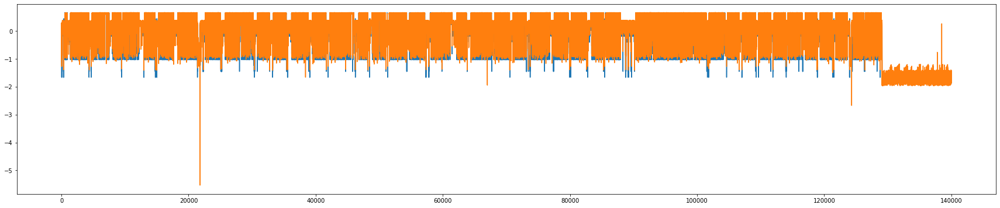

In [ ]:
from matplotlib.pyplot import figure
plt.figure(figsize=(30,6))
x_train_seq=X_train_scaled.T
x_train_pred_seq=x_train_pred.T
plt.plot(x_train_seq[1])
plt.plot(x_train_pred_seq[1])


plt.show()

In [ ]:
fig = px.scatter(x=x_train_seq[2], y=x_train_pred_seq[2], title='Outlier Detection')
fig.show()